In [86]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sn
from matplotlib.colors import ListedColormap
from sklearn import neighbors, datasets
from sklearn.metrics import confusion_matrix


from sklearn.neighbors import NearestNeighbors, KNeighborsClassifier
from sklearn.model_selection import train_test_split


data = pd.read_csv("BathSoap.csv")

data

,Member id,SEC,FEH,MT,SEX,AGE,EDU,HS,CHILD,CS,...,PropCat 6,PropCat 7,PropCat 8,PropCat 9,PropCat 10,PropCat 11,PropCat 12,PropCat 13,PropCat 14,PropCat 15
0,1010010,4,3,10,1,4,4,2,4,1,...,0%,0%,0%,0%,0%,0%,3%,0%,13%,34%
1,1010020,3,2,10,2,2,4,4,2,1,...,35%,3%,2%,1%,0%,6%,0%,0%,8%,0%
2,1014020,2,3,10,2,4,5,6,4,1,...,12%,3%,1%,1%,0%,0%,2%,0%,56%,0%
3,1014030,4,0,0,0,4,0,0,5,0,...,0%,0%,0%,0%,0%,0%,0%,0%,60%,0%
4,1014190,4,1,10,2,3,4,4,3,1,...,0%,0%,5%,0%,0%,0%,0%,0%,14%,0%
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
595,1167090,2,3,10,2,4,5,5,4,1,...,0%,0%,0%,0%,2%,90%,0%,0%,0%,0%
596,1167230,3,3,10,2,3,5,4,4,1,...,43%,7%,15%,0%,4%,0%,0%,9%,0%,5%
597,1167340,3,3,17,2,4,4,9,4,1,...,13%,0%,3%,0%,4%,0%,0%,0%,18%,0%
598,1167350,2,1,4,2,4,5,2,4,2,...,15%,0%,0%,0%,0%,0%,0%,3%,14%,0%


Kmeans clustering can only handle numeric data. Thus all the percentages need to be converted over to a numeric value by removing the percent symbol and converting them to floating point numbers.

In [87]:
data = data.drop(['Member id'], axis=1)
data = data.dropna()

data['Pur Vol No Promo - %']  = data['Pur Vol No Promo - %'].apply(lambda x: float(x[:-1]) / 100)
data['Pur Vol Promo 6 %']     = data['Pur Vol Promo 6 %'].apply(lambda x: float(x[:-1]) / 100)
data['Pur Vol Other Promo %'] = data['Pur Vol Other Promo %'].apply(lambda x: float(x[:-1]) / 100)
data['Br. Cd. 57, 144']       = data['Br. Cd. 57, 144'].apply(lambda x: float(x[:-1]) / 100)
data['Br. Cd. 55']            = data['Br. Cd. 55'].apply(lambda x: float(x[:-1]) / 100)
data['Br. Cd. 272']           = data['Br. Cd. 272'].apply(lambda x: float(x[:-1]) / 100)
data['Br. Cd. 286']           = data['Br. Cd. 286'].apply(lambda x: float(x[:-1]) / 100)
data['Br. Cd. 24']            = data['Br. Cd. 24'].apply(lambda x: float(x[:-1]) / 100)
data['Br. Cd. 481']           = data['Br. Cd. 481'].apply(lambda x: float(x[:-1]) / 100)
data['Br. Cd. 352']           = data['Br. Cd. 352'].apply(lambda x: float(x[:-1]) / 100)
data['Br. Cd. 5']             = data['Br. Cd. 5'].apply(lambda x: float(x[:-1]) / 100)
data['Others 999']            = data['Others 999'].apply(lambda x: float(x[:-1]) / 100)

data['Pr Cat 1'] = data['Pr Cat 1'].apply(lambda x: float(x[:-1]) / 100)
data['Pr Cat 2'] = data['Pr Cat 2'].apply(lambda x: float(x[:-1]) / 100)
data['Pr Cat 3'] = data['Pr Cat 3'].apply(lambda x: float(x[:-1]) / 100)
data['Pr Cat 4'] = data['Pr Cat 4'].apply(lambda x: float(x[:-1]) / 100)

data['PropCat 5']  = data['PropCat 5'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 6']  = data['PropCat 6'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 7']  = data['PropCat 7'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 8']  = data['PropCat 8'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 9']  = data['PropCat 9'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 10'] = data['PropCat 10'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 11'] = data['PropCat 11'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 12'] = data['PropCat 12'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 13'] = data['PropCat 13'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 14'] = data['PropCat 14'].apply(lambda x: float(x[:-1]) / 100)
data['PropCat 15'] = data['PropCat 15'].apply(lambda x: float(x[:-1]) / 100)

,SEC,FEH,MT,SEX,AGE,EDU,HS,CHILD,CS,Affluence Index,...,PropCat 6,PropCat 7,PropCat 8,PropCat 9,PropCat 10,PropCat 11,PropCat 12,PropCat 13,PropCat 14,PropCat 15
0,4,3,10,1,4,4,2,4,1,2,...,0.00,0.00,0.00,0.00,0.00,0.00,0.03,0.00,0.13,0.34
1,3,2,10,2,2,4,4,2,1,19,...,0.35,0.03,0.02,0.01,0.00,0.06,0.00,0.00,0.08,0.00
2,2,3,10,2,4,5,6,4,1,23,...,0.12,0.03,0.01,0.01,0.00,0.00,0.02,0.00,0.56,0.00
3,4,0,0,0,4,0,0,5,0,0,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.60,0.00
4,4,1,10,2,3,4,4,3,1,10,...,0.00,0.00,0.05,0.00,0.00,0.00,0.00,0.00,0.14,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
595,2,3,10,2,4,5,5,4,1,15,...,0.00,0.00,0.00,0.00,0.02,0.90,0.00,0.00,0.00,0.00
596,3,3,10,2,3,5,4,4,1,29,...,0.43,0.07,0.15,0.00,0.04,0.00,0.00,0.09,0.00,0.05
597,3,3,17,2,4,4,9,4,1,13,...,0.13,0.00,0.03,0.00,0.04,0.00,0.00,0.00,0.18,0.00
598,2,1,4,2,4,5,2,4,2,20,...,0.15,0.00,0.00,0.00,0.00,0.00,0.00,0.03,0.14,0.00


In [256]:
cols_to_norm = [
"SEC",
"MT",
"AGE",
"EDU",
"HS",
"CHILD",
"SEX",
"FEH",
"CS",
"Affluence Index",
"No. of Brands",
"Brand Runs",
"Total Volume",
"No. of  Trans",
"Value",
"Trans / Brand Runs",
"Vol/Tran",
"Avg. Price",
"Pur Vol No Promo - %",
"Pur Vol Promo 6 %",
"Pur Vol Other Promo %",
"Br. Cd. 57, 144",
"Br. Cd. 55",
"Br. Cd. 272",
"Br. Cd. 286",
"Br. Cd. 24",
"Br. Cd. 481",
"Br. Cd. 352",
"Br. Cd. 5",
"Others 999",

"Pr Cat 1",
"Pr Cat 2",
"Pr Cat 3",
"Pr Cat 4",

"PropCat 5",
"PropCat 6",
"PropCat 7",
"PropCat 8",
"PropCat 9",
"PropCat 10",
"PropCat 11",
"PropCat 12",
"PropCat 13",
"PropCat 14",
"PropCat 15"
]

data[cols_to_norm] = data[cols_to_norm].apply(lambda x: (x - x.min()) / (x.max() - x.min()))

In [139]:
purchaseBehavior = data.loc[:, [
"No. of Brands",
"Brand Runs",
"Total Volume",
"No. of  Trans",
"Value",
"Trans / Brand Runs",
"Vol/Tran",
"Avg. Price",
"Pur Vol No Promo - %",
"Pur Vol Promo 6 %",
"Pur Vol Other Promo %",
"Br. Cd. 57, 144",
"Br. Cd. 55",
"Br. Cd. 272",
"Br. Cd. 286",
"Br. Cd. 24",
"Br. Cd. 481",
"Br. Cd. 352",
"Br. Cd. 5",
"Others 999"
]]
basisOfPurchase  = data.loc[:,[
"Pr Cat 1",
"Pr Cat 2",
"Pr Cat 3",
"Pr Cat 4",
"PropCat 5",
"PropCat 6",
"PropCat 7",
"PropCat 8",
"PropCat 9",
"PropCat 10",
"PropCat 11",
"PropCat 12",
"PropCat 13",
"PropCat 14",
"PropCat 15"
]]

both = data.loc[:,[
"No. of Brands",
"Brand Runs",
"Total Volume",
"No. of  Trans",
"Value",
"Trans / Brand Runs",
"Vol/Tran",
"Avg. Price",
"Pur Vol No Promo - %",
"Pur Vol Promo 6 %",
"Pur Vol Other Promo %",
"Br. Cd. 57, 144",
"Br. Cd. 55",
"Br. Cd. 272",
"Br. Cd. 286",
"Br. Cd. 24",
"Br. Cd. 481",
"Br. Cd. 352",
"Br. Cd. 5",
"Others 999",
"Pr Cat 1",
"Pr Cat 2",
"Pr Cat 3",
"Pr Cat 4",
"PropCat 5",
"PropCat 6",
"PropCat 7",
"PropCat 8",
"PropCat 9",
"PropCat 10",
"PropCat 11",
"PropCat 12",
"PropCat 13",
"PropCat 14",
"PropCat 15"
]]

For n_clusters = 2 The average silhouette_score is : 0.2190140329635711
For n_clusters = 3 The average silhouette_score is : 0.2393152208038916
For n_clusters = 4 The average silhouette_score is : 0.20639399754723076
For n_clusters = 5 The average silhouette_score is : 0.22469297322765266


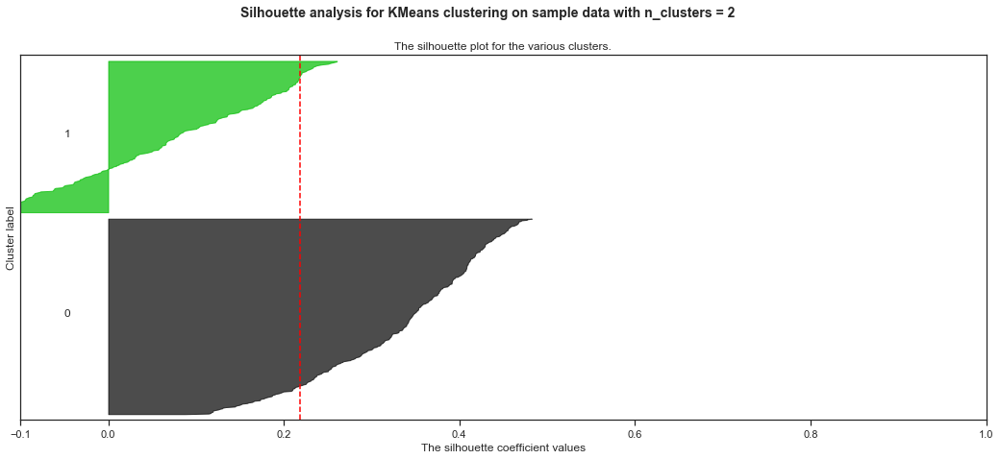

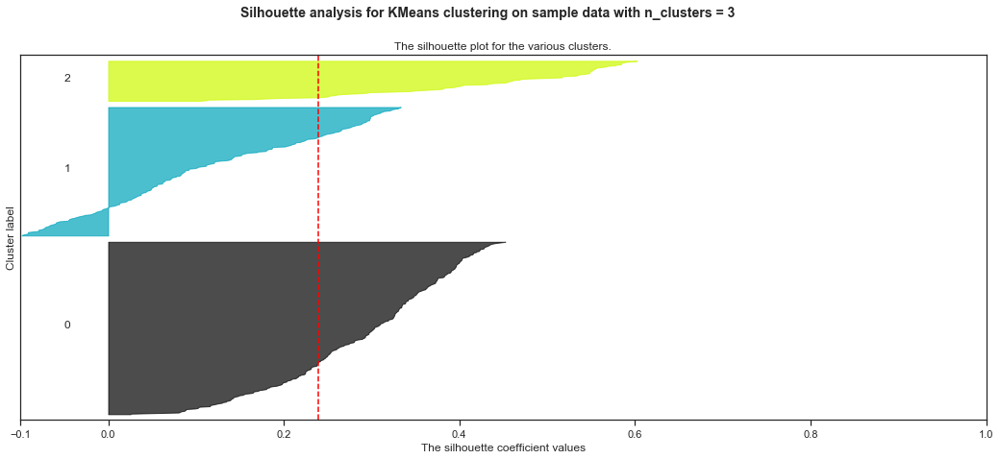

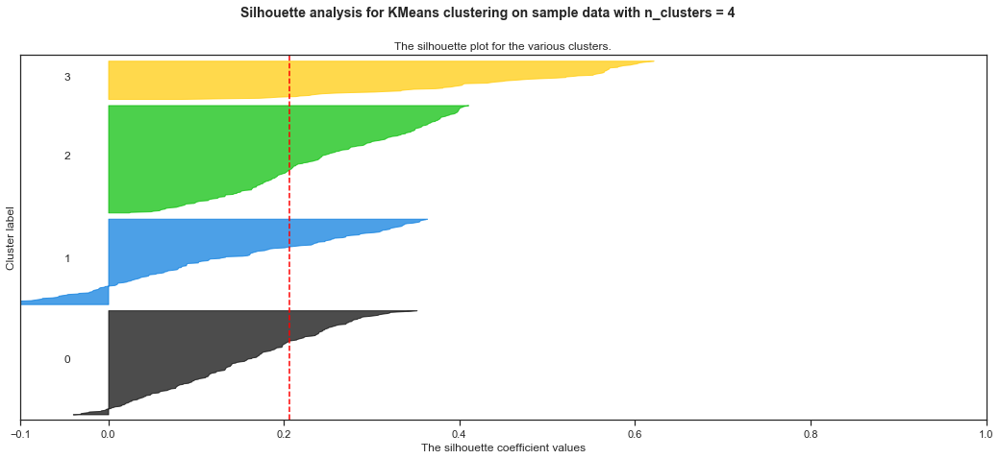

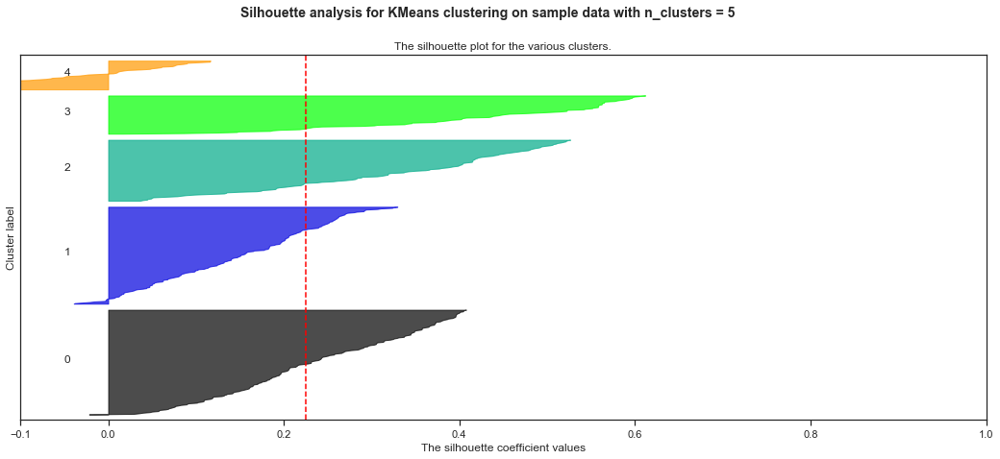

In [141]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm


range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    X = purchaseBehavior
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on Purchase Behavior "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

For n_clusters = 2 The average silhouette_score is : 0.3794143469080903
For n_clusters = 3 The average silhouette_score is : 0.29851004194995395
For n_clusters = 4 The average silhouette_score is : 0.3103266767698458
For n_clusters = 5 The average silhouette_score is : 0.289900939773538


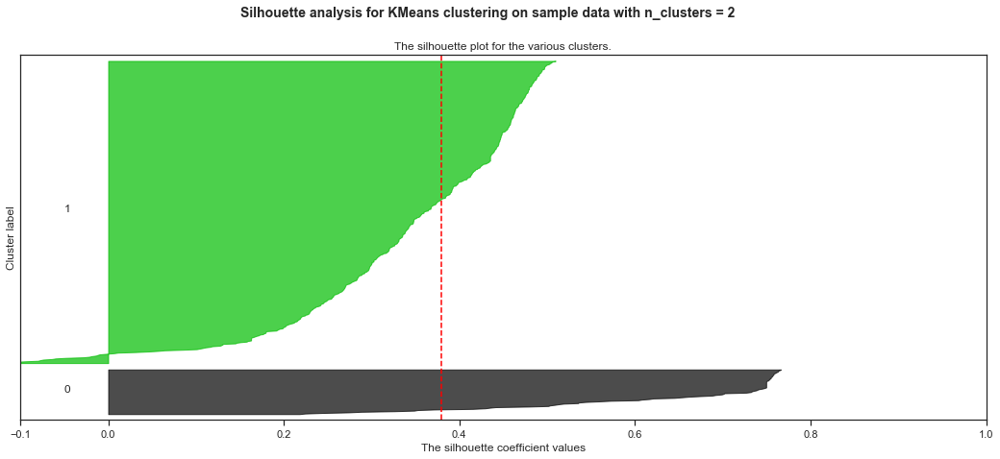

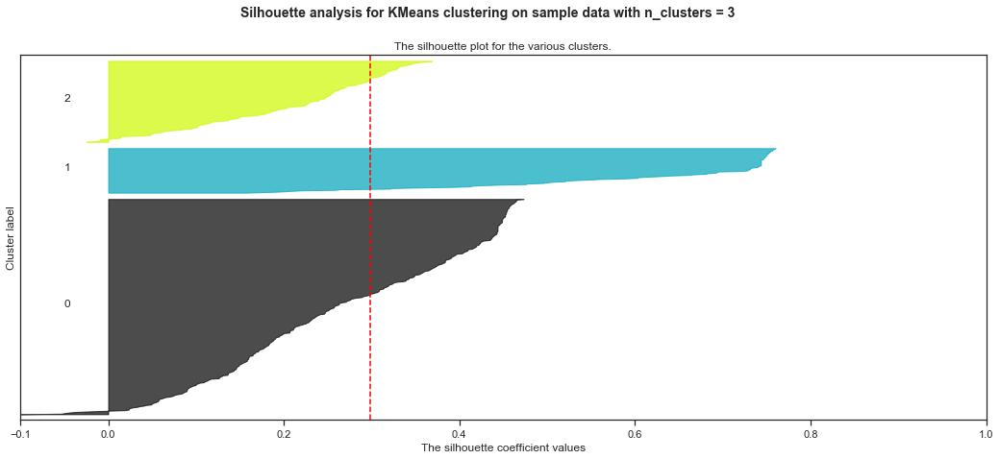

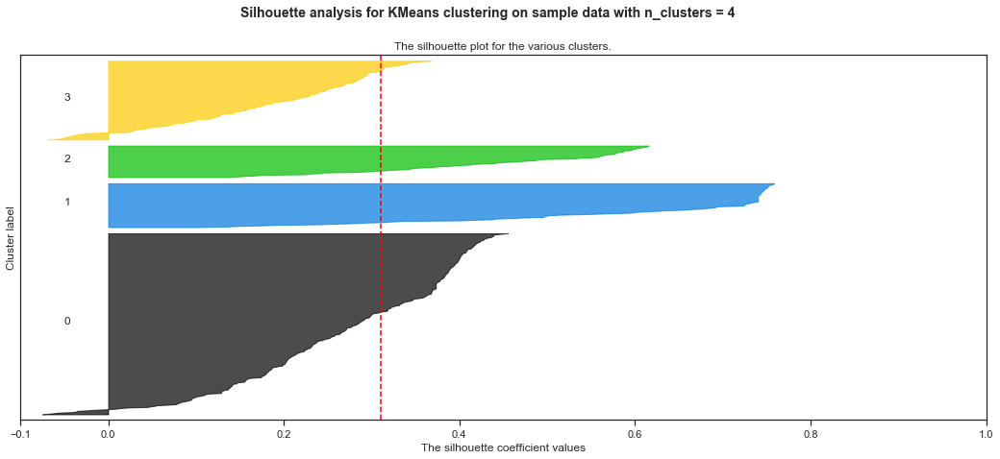

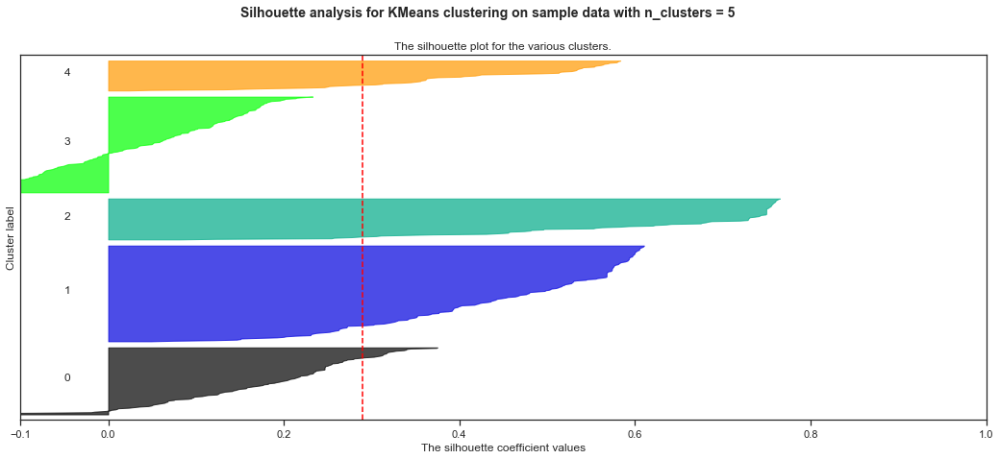

In [142]:
range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    X = basisOfPurchase
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on Basis of Purchase "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

For n_clusters = 2 The average silhouette_score is : 0.33115517004076717
For n_clusters = 3 The average silhouette_score is : 0.19209489417204276
For n_clusters = 4 The average silhouette_score is : 0.1784949564016298
For n_clusters = 5 The average silhouette_score is : 0.20459840029904255


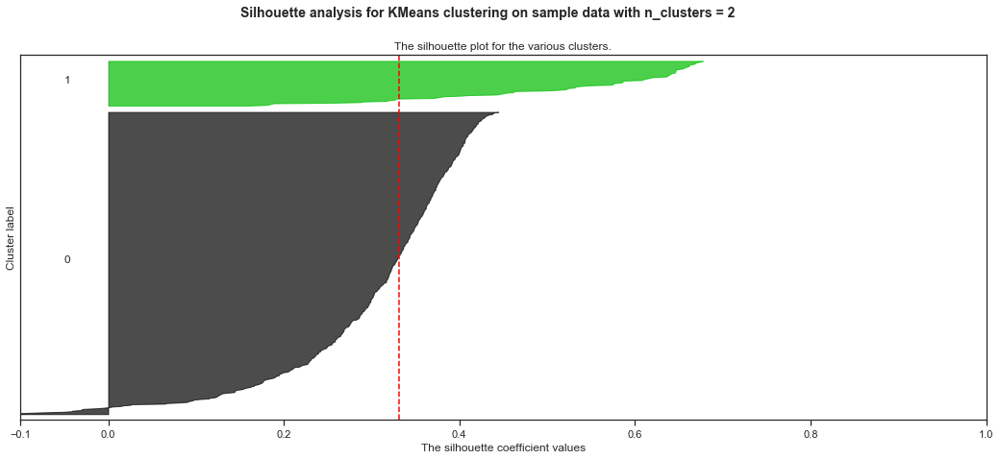

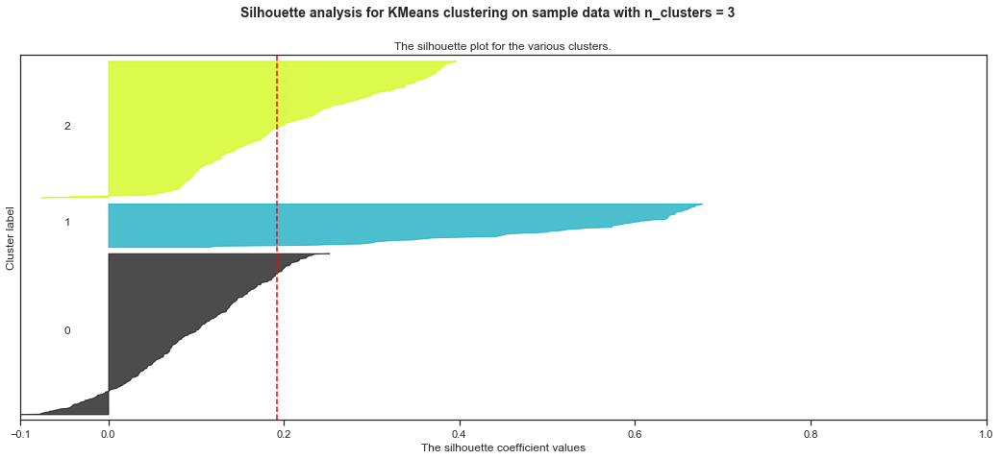

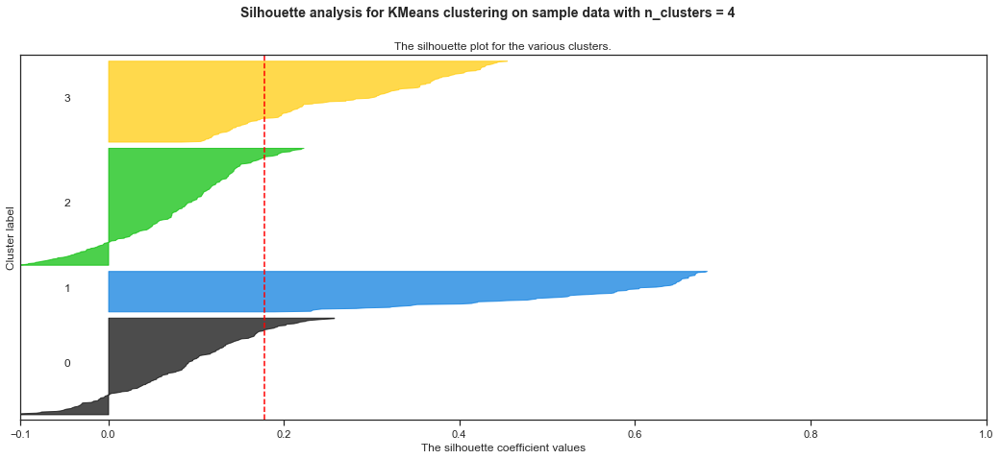

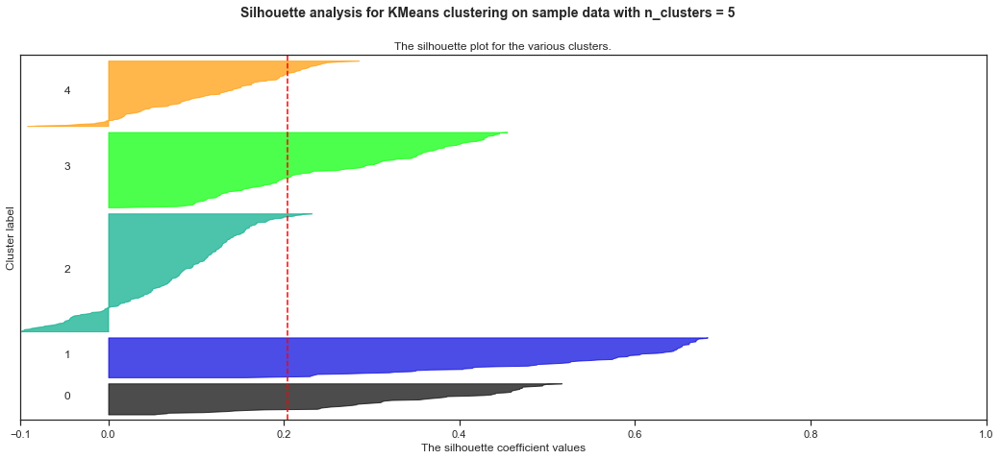

In [143]:
range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    X = both
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on Both Basis of Purchase and Purchase Behavior "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

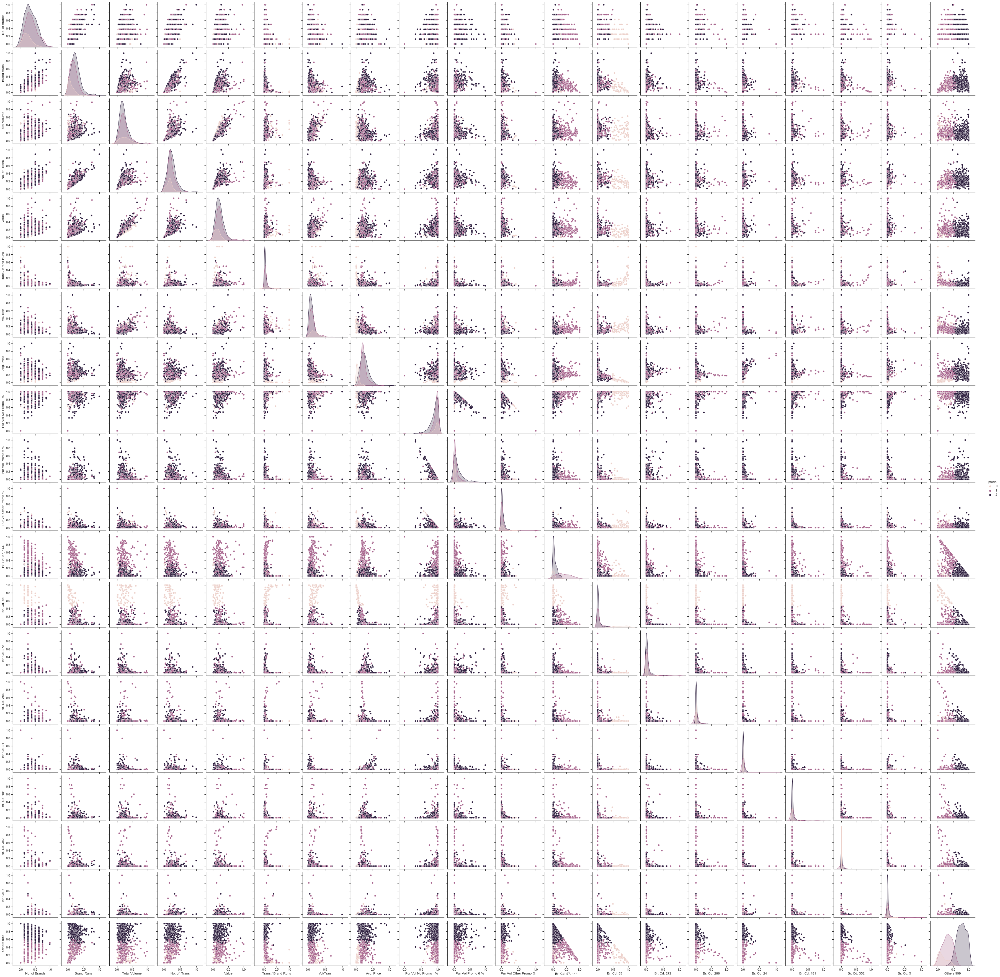

In [145]:
kmeans = KMeans(n_clusters=3, random_state=0).fit(purchaseBehavior)
purchaseBehavior['preds'] = kmeans.predict(purchaseBehavior)
sns.pairplot(purchaseBehavior, hue='preds')

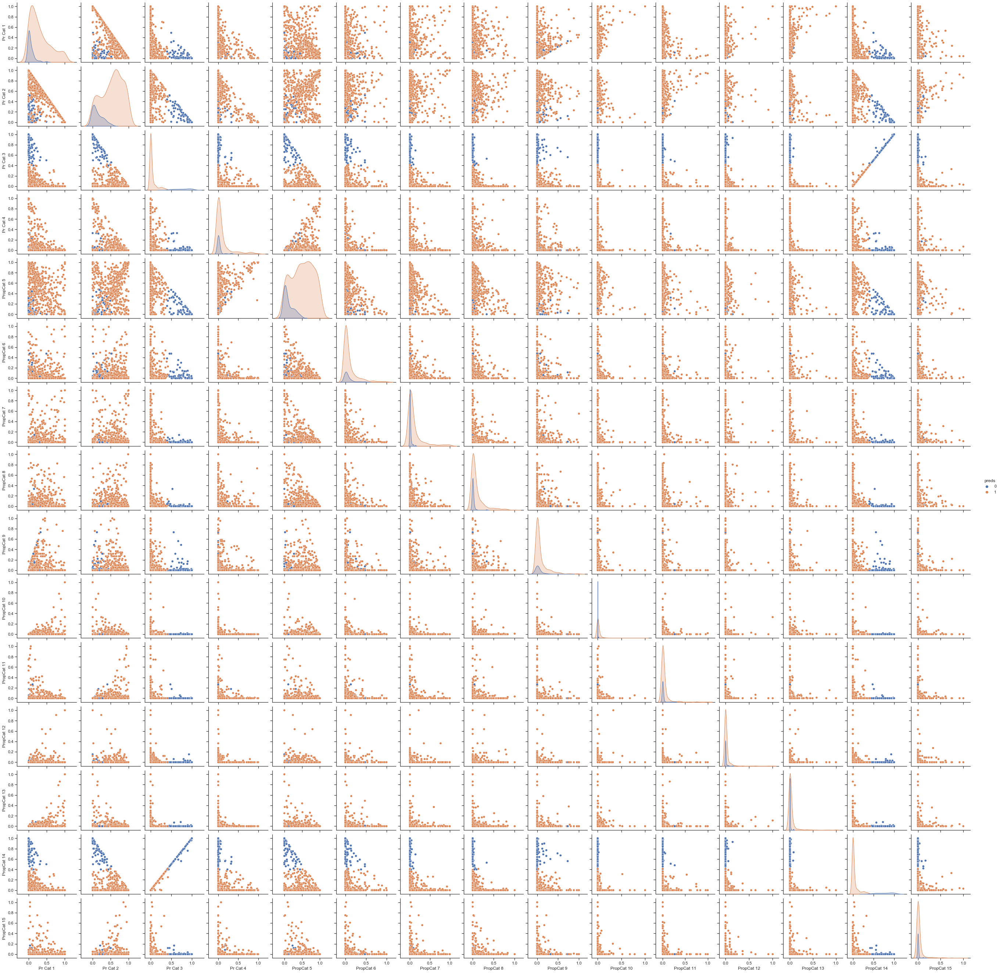

In [146]:
kmeans = KMeans(n_clusters=2, random_state=0).fit(basisOfPurchase)
basisOfPurchase['preds'] = kmeans.predict(basisOfPurchase)
sns.pairplot(basisOfPurchase, hue='preds')

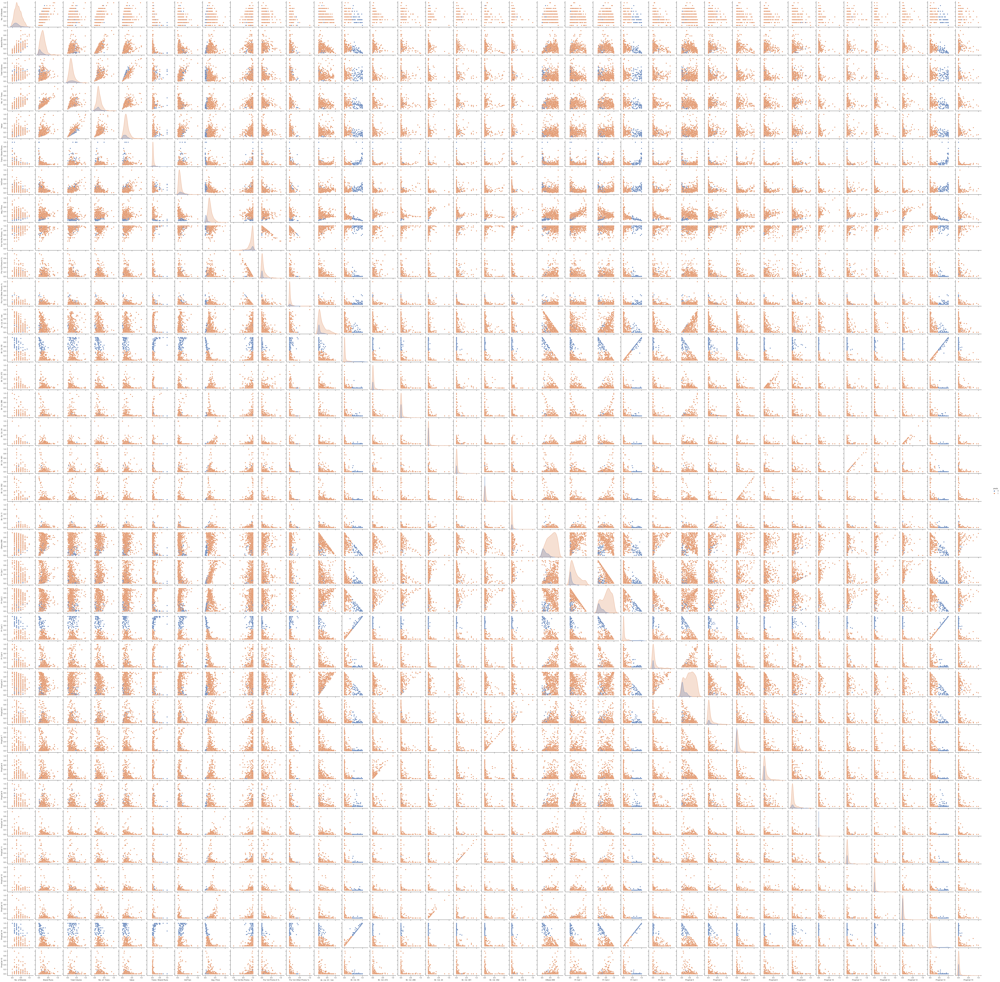

In [147]:
kmeans = KMeans(n_clusters=2, random_state=0).fit(both)
both['preds'] = kmeans.predict(both)
sns.pairplot(both, hue='preds')

In [330]:
altData = pd.read_csv("BathSoap.csv")

altData = altData.drop(['Member id'], axis=1)
altData = altData.dropna()

altData['Pur Vol No Promo - %']  = altData['Pur Vol No Promo - %'].apply(lambda x: float(x[:-1]) / 100)
altData['Pur Vol Promo 6 %']     = altData['Pur Vol Promo 6 %'].apply(lambda x: float(x[:-1]) / 100)
altData['Pur Vol Other Promo %'] = altData['Pur Vol Other Promo %'].apply(lambda x: float(x[:-1]) / 100)
altData['Br. Cd. 57, 144']       = altData['Br. Cd. 57, 144'].apply(lambda x: float(x[:-1]) / 100)
altData['Br. Cd. 55']            = altData['Br. Cd. 55'].apply(lambda x: float(x[:-1]) / 100)
altData['Br. Cd. 272']           = altData['Br. Cd. 272'].apply(lambda x: float(x[:-1]) / 100)
altData['Br. Cd. 286']           = altData['Br. Cd. 286'].apply(lambda x: float(x[:-1]) / 100)
altData['Br. Cd. 24']            = altData['Br. Cd. 24'].apply(lambda x: float(x[:-1]) / 100)
altData['Br. Cd. 481']           = altData['Br. Cd. 481'].apply(lambda x: float(x[:-1]) / 100)
altData['Br. Cd. 352']           = altData['Br. Cd. 352'].apply(lambda x: float(x[:-1]) / 100)
altData['Br. Cd. 5']             = altData['Br. Cd. 5'].apply(lambda x: float(x[:-1]) / 100)
altData['Others 999']            = altData['Others 999'].apply(lambda x: float(x[:-1]) / 100)

altData['Pr Cat 1'] = altData['Pr Cat 1'].apply(lambda x: float(x[:-1]) / 100)
altData['Pr Cat 2'] = altData['Pr Cat 2'].apply(lambda x: float(x[:-1]) / 100)
altData['Pr Cat 3'] = altData['Pr Cat 3'].apply(lambda x: float(x[:-1]) / 100)
altData['Pr Cat 4'] = altData['Pr Cat 4'].apply(lambda x: float(x[:-1]) / 100)

altData['PropCat 5']  = altData['PropCat 5'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 6']  = altData['PropCat 6'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 7']  = altData['PropCat 7'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 8']  = altData['PropCat 8'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 9']  = altData['PropCat 9'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 10'] = altData['PropCat 10'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 11'] = altData['PropCat 11'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 12'] = altData['PropCat 12'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 13'] = altData['PropCat 13'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 14'] = altData['PropCat 14'].apply(lambda x: float(x[:-1]) / 100)
altData['PropCat 15'] = altData['PropCat 15'].apply(lambda x: float(x[:-1]) / 100)


# Create a new varaible representing the single brand with the most purchase. This means that individuals who switch brands frequently will have their purchases spread out across multiple whereas individuals who stick with a single brand would have their purchases focused.
# The higher the number the more focused the purchases are on a specific brand.

temp = altData.loc[:, ["Br. Cd. 57, 144", "Br. Cd. 55", "Br. Cd. 272", "Br. Cd. 286", "Br. Cd. 24", "Br. Cd. 24", "Br. Cd. 352", "Br. Cd. 5"]]

altData['brandLoyalty'] = temp.max(axis=1) / temp.sum(axis=1)
altData['brandLoyalty'] = altData['brandLoyalty'].fillna(0)

    
cols_to_norm = [
# "SEC",
# "MT",
# "AGE",
# "EDU",
# "HS",
# "Affluence Index",
"No. of Brands",
"Brand Runs",
"Total Volume",
"No. of  Trans",
"Value",
"Trans / Brand Runs",
"Vol/Tran",
"Avg. Price",
"Pur Vol No Promo - %",
"Pur Vol Promo 6 %",
"Pur Vol Other Promo %",
"Br. Cd. 57, 144",
"Br. Cd. 55",
"Br. Cd. 272",
"Br. Cd. 286",
"Br. Cd. 24",
"Br. Cd. 481",
"Br. Cd. 352",
"Br. Cd. 5",
"Others 999",

"Pr Cat 1",
"Pr Cat 2",
"Pr Cat 3",
"Pr Cat 4",

"PropCat 5",
"PropCat 6",
"PropCat 7",
"PropCat 8",
"PropCat 9",
"PropCat 10",
"PropCat 11",
"PropCat 12",
"PropCat 13",
"PropCat 14",
"PropCat 15",
"brandLoyalty"
]

altData[cols_to_norm] = altData[cols_to_norm].apply(lambda x: (x - x.min()) / (x.max() - x.min()))

In [331]:
altData

,SEC,FEH,MT,SEX,AGE,EDU,HS,CHILD,CS,Affluence Index,...,PropCat 7,PropCat 8,PropCat 9,PropCat 10,PropCat 11,PropCat 12,PropCat 13,PropCat 14,PropCat 15,brandLoyalty
0,4,3,10,1,4,4,2,4,1,2,...,0.00,0.000000,0.00000,0.00,0.000000,0.090909,0.00,0.13,0.404762,0.745098
1,3,2,10,2,2,4,4,2,1,19,...,0.03,0.020833,0.02439,0.00,0.066667,0.000000,0.00,0.08,0.000000,0.583333
2,2,3,10,2,4,5,6,4,1,23,...,0.03,0.010417,0.02439,0.00,0.000000,0.060606,0.00,0.56,0.000000,0.873016
3,4,0,0,0,4,0,0,5,0,0,...,0.00,0.000000,0.00000,0.00,0.000000,0.000000,0.00,0.60,0.000000,0.600000
4,4,1,10,2,3,4,4,3,1,10,...,0.00,0.052083,0.00000,0.00,0.000000,0.000000,0.00,0.14,0.000000,0.736842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
595,2,3,10,2,4,5,5,4,1,15,...,0.00,0.000000,0.00000,0.02,1.000000,0.000000,0.00,0.00,0.000000,1.000000
596,3,3,10,2,3,5,4,4,1,29,...,0.07,0.156250,0.00000,0.04,0.000000,0.000000,0.09,0.00,0.059524,0.243902
597,3,3,17,2,4,4,9,4,1,13,...,0.00,0.031250,0.00000,0.04,0.000000,0.000000,0.00,0.18,0.000000,0.555556
598,2,1,4,2,4,5,2,4,2,20,...,0.00,0.000000,0.00000,0.00,0.000000,0.000000,0.03,0.14,0.000000,0.647059


In [332]:
allData = altData.loc[:,[
"SEC",
"MT",
"AGE",
"EDU",
"HS",
"Affluence Index",
"No. of Brands",
"Brand Runs",
"Total Volume",
"No. of  Trans",
"Value",
"Trans / Brand Runs",
"Vol/Tran",
"Avg. Price",
"Pur Vol No Promo - %",
"Pur Vol Promo 6 %",
"Pur Vol Other Promo %",
"Br. Cd. 57, 144",
"Br. Cd. 55",
"Br. Cd. 272",
"Br. Cd. 286",
"Br. Cd. 24",
"Br. Cd. 481",
"Br. Cd. 352",
"Br. Cd. 5",
"Others 999",
"Pr Cat 1",
"Pr Cat 2",
"Pr Cat 3",
"Pr Cat 4",
"PropCat 5",
"PropCat 6",
"PropCat 7",
"PropCat 8",
"PropCat 9",
"PropCat 10",
"PropCat 11",
"PropCat 12",
"PropCat 13",
"PropCat 14",
"PropCat 15",
"brandLoyalty"
]]


In [333]:
purchaseBehaviorDerived = allData.loc[:, [
"No. of Brands",
"Brand Runs",
"Total Volume",
"No. of  Trans",
"Value",
"Trans / Brand Runs",
"Vol/Tran",
"Avg. Price",
"Pur Vol No Promo - %",
"Pur Vol Promo 6 %",
"Pur Vol Other Promo %",
# "Others 999",
"brandLoyalty"]]

propCat  = allData.loc[:,[
"PropCat 5",
"PropCat 6",
"PropCat 7",
"PropCat 8",
"PropCat 9",
"PropCat 10",
"PropCat 11",
"PropCat 12",
"PropCat 13",
"PropCat 14",
"PropCat 15"]]

priceCat  = allData.loc[:,[
"Pr Cat 1",
"Pr Cat 2",
"Pr Cat 3",
"Pr Cat 4"]]

basisForPurchase  = allData.loc[:,[
"PropCat 5",
"PropCat 6",
"PropCat 7",
"PropCat 8",
"PropCat 9",
"PropCat 10",
"PropCat 11",
"PropCat 12",
"PropCat 13",
"PropCat 14",
"PropCat 15",
"Pr Cat 1",
"Pr Cat 2",
"Pr Cat 3",
"Pr Cat 4"]]

both = allData.loc[:,[
"No. of Brands",
"Brand Runs",
"Total Volume",
"No. of  Trans",
"Value",
"Trans / Brand Runs",
"Vol/Tran",
"Avg. Price",
"Pur Vol No Promo - %",
"Pur Vol Promo 6 %",
"Pur Vol Other Promo %",
"PropCat 5",
"PropCat 6",
"PropCat 7",
"PropCat 8",
"PropCat 9",
"PropCat 10",
"PropCat 11",
"PropCat 12",
"PropCat 13",
"PropCat 14",
"PropCat 15",
"Pr Cat 1",
"Pr Cat 2",
"Pr Cat 3",
"Pr Cat 4",
# "Others 999",
"brandLoyalty"]]


For n_clusters = 2 The average silhouette_score is : 0.2597175613218027
For n_clusters = 3 The average silhouette_score is : 0.2719857051699841
For n_clusters = 4 The average silhouette_score is : 0.2346373107959679
For n_clusters = 5 The average silhouette_score is : 0.265280244184188


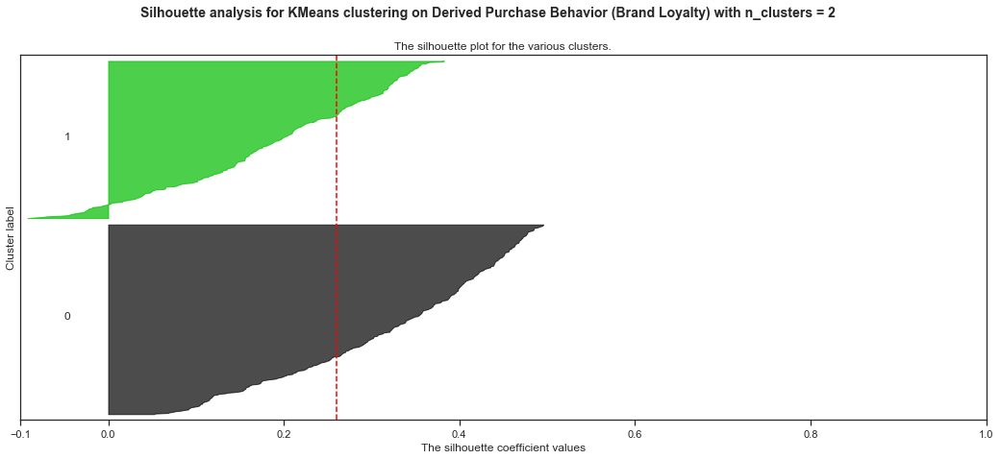

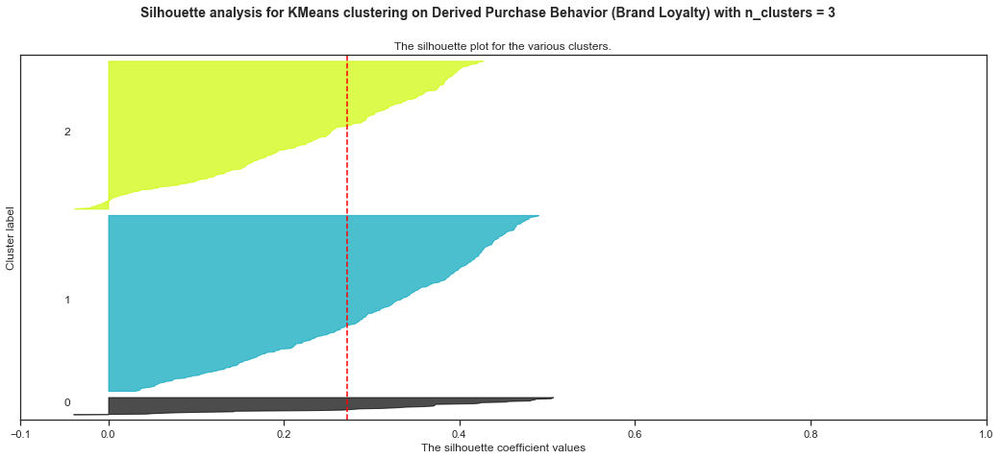

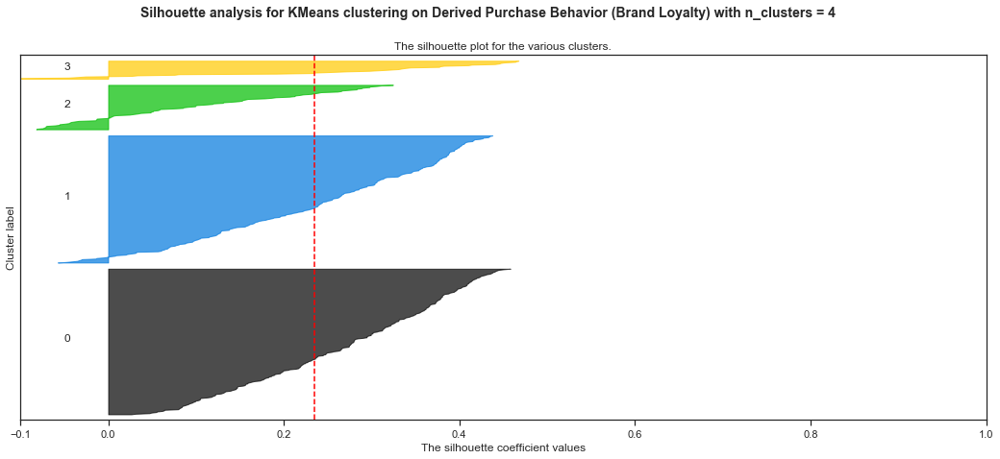

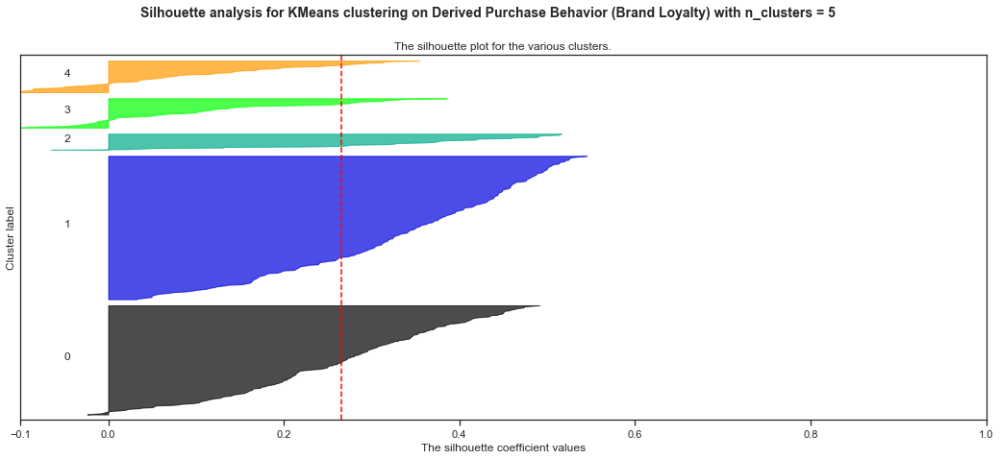

In [334]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm


range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    X = purchaseBehaviorDerived
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on Derived Purchase Behavior (Brand Loyalty) "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

For n_clusters = 2 The average silhouette_score is : 0.30784011436080627
For n_clusters = 3 The average silhouette_score is : 0.33878196420200446
For n_clusters = 4 The average silhouette_score is : 0.35642026486815864
For n_clusters = 5 The average silhouette_score is : 0.3697269869409852


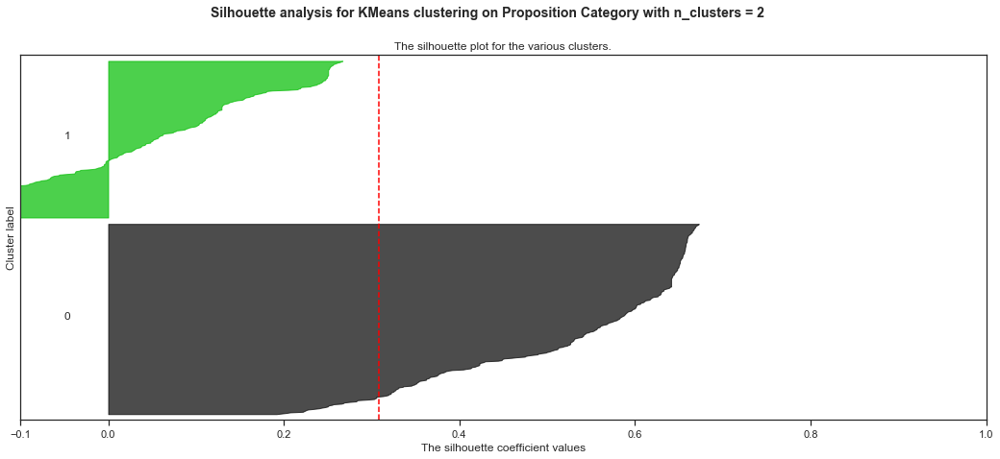

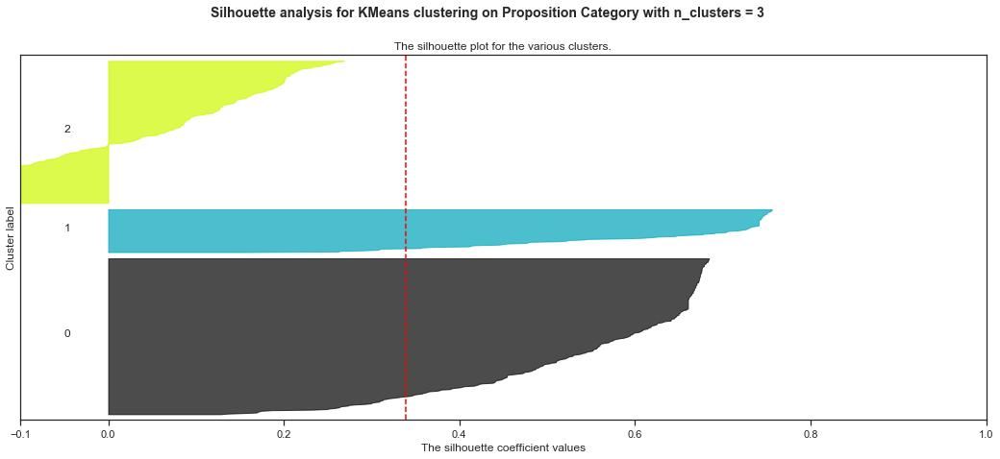

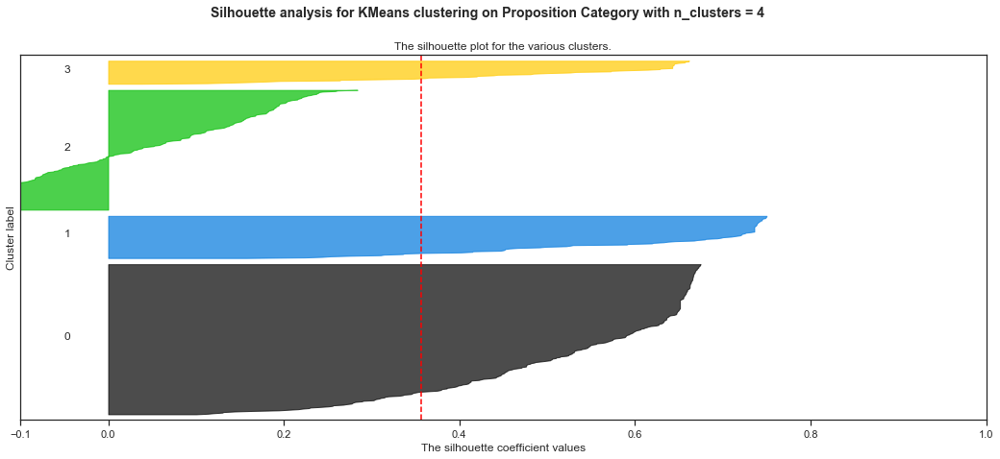

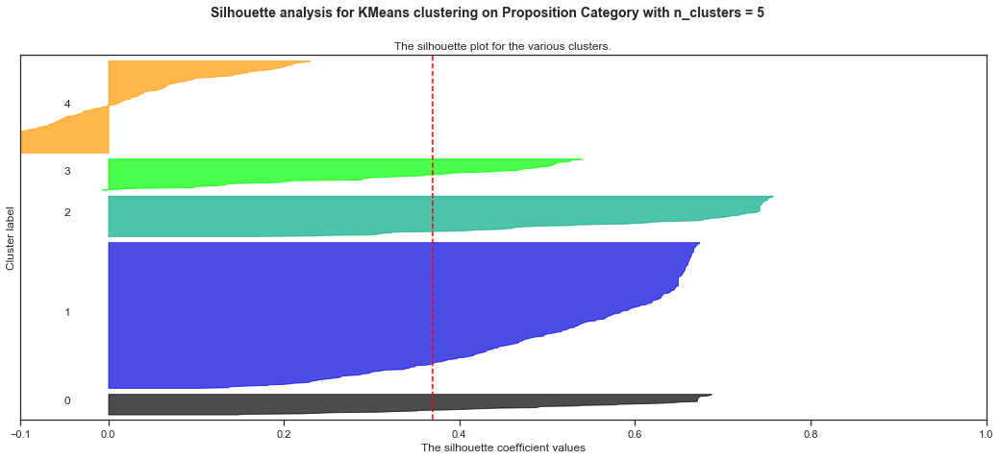

In [335]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm


range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    X = propCat
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on Proposition Category "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

For n_clusters = 2 The average silhouette_score is : 0.3991514924267952
For n_clusters = 3 The average silhouette_score is : 0.4942039332477905
For n_clusters = 4 The average silhouette_score is : 0.5627934024187058
For n_clusters = 5 The average silhouette_score is : 0.46228061007413174


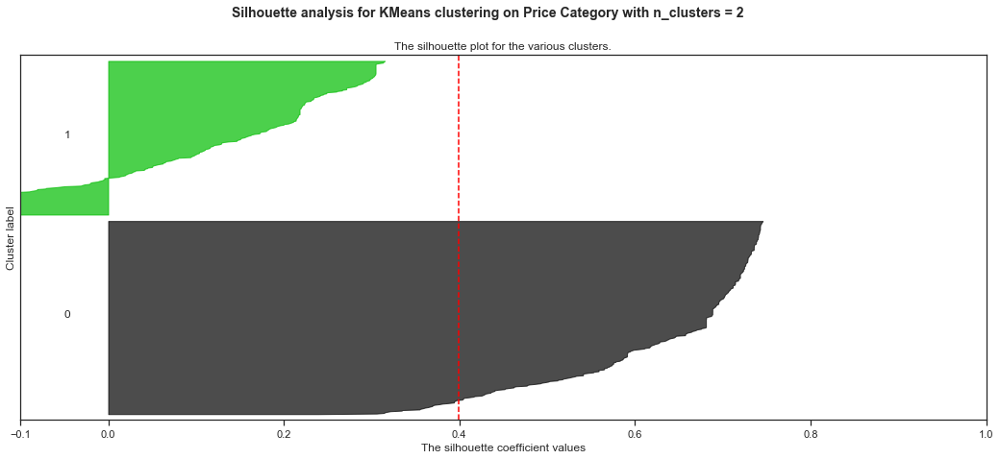

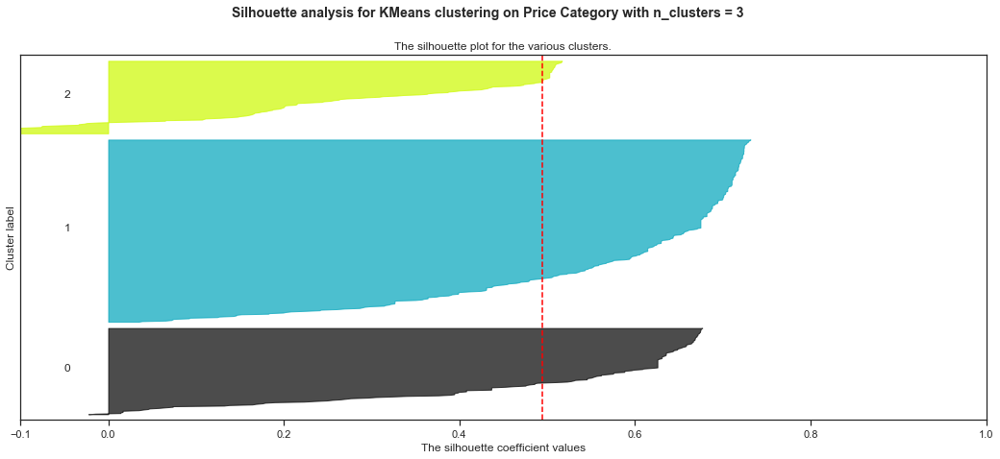

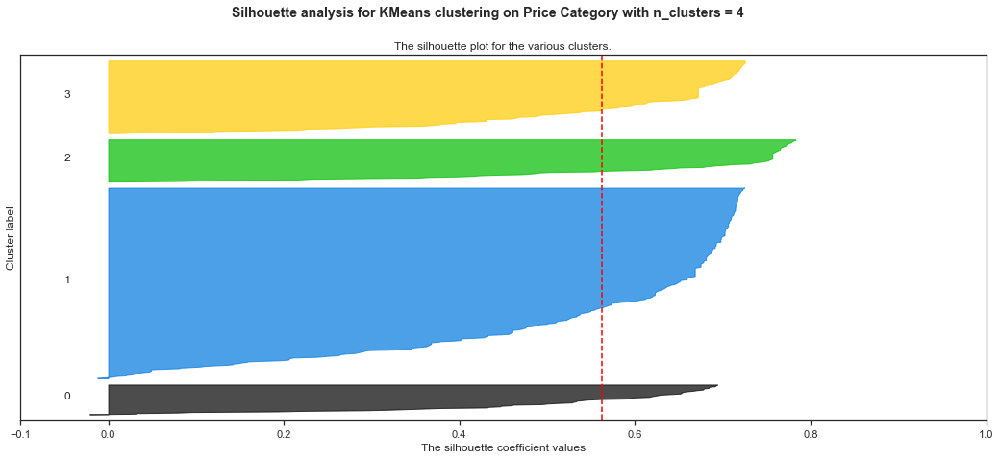

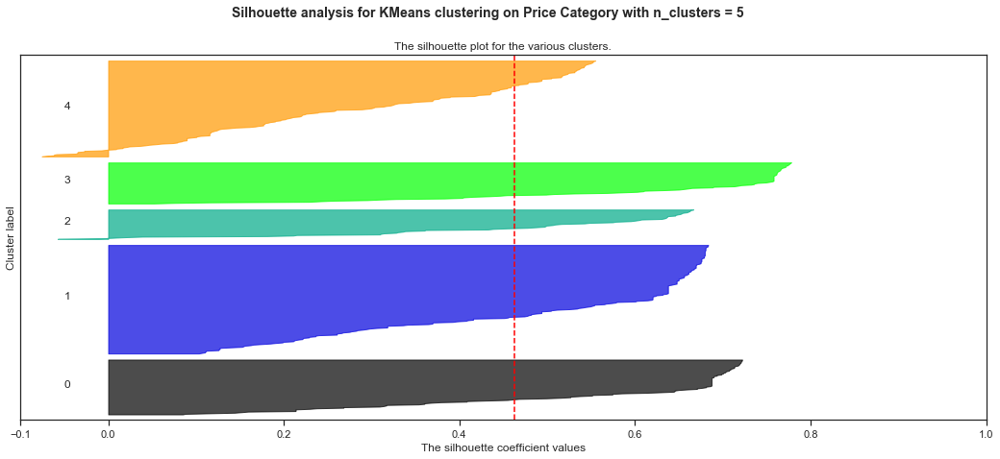

In [336]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm


range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    X = priceCat
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on Price Category "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

For n_clusters = 2 The average silhouette_score is : 0.37941434690809034
For n_clusters = 3 The average silhouette_score is : 0.29851004194995395
For n_clusters = 4 The average silhouette_score is : 0.31032667676984577
For n_clusters = 5 The average silhouette_score is : 0.289900939773538


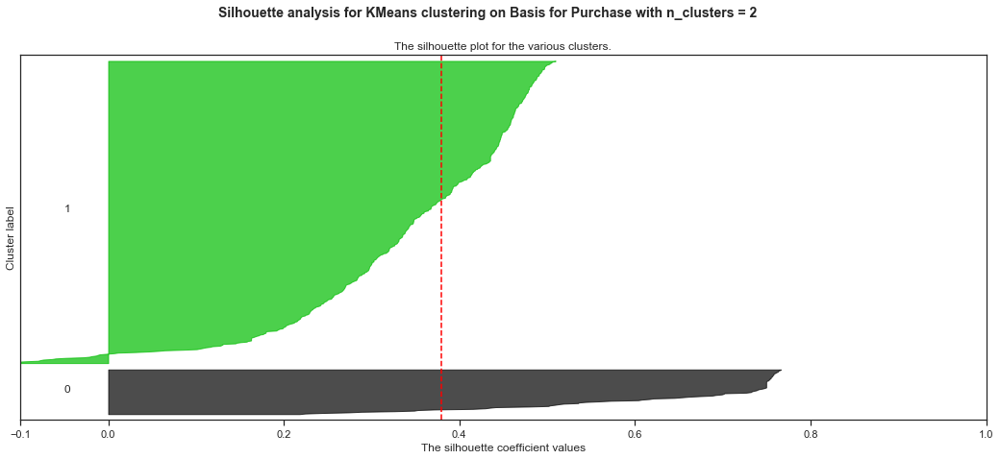

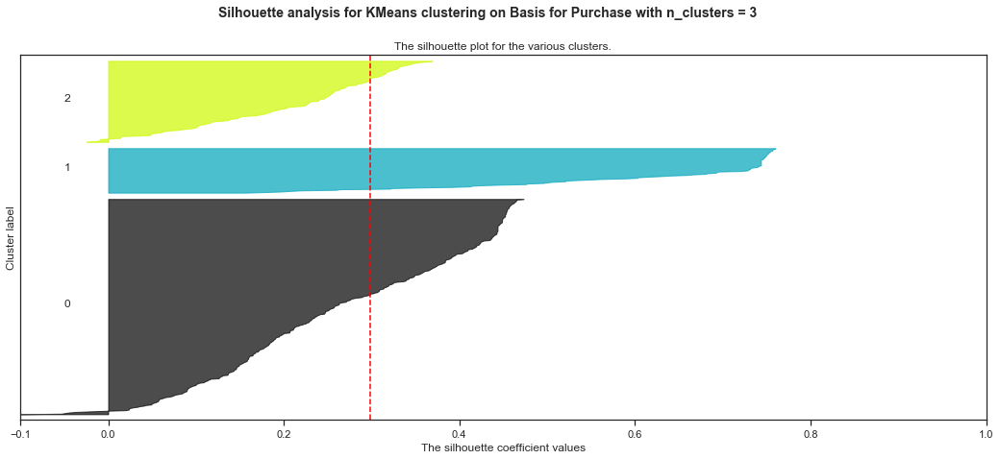

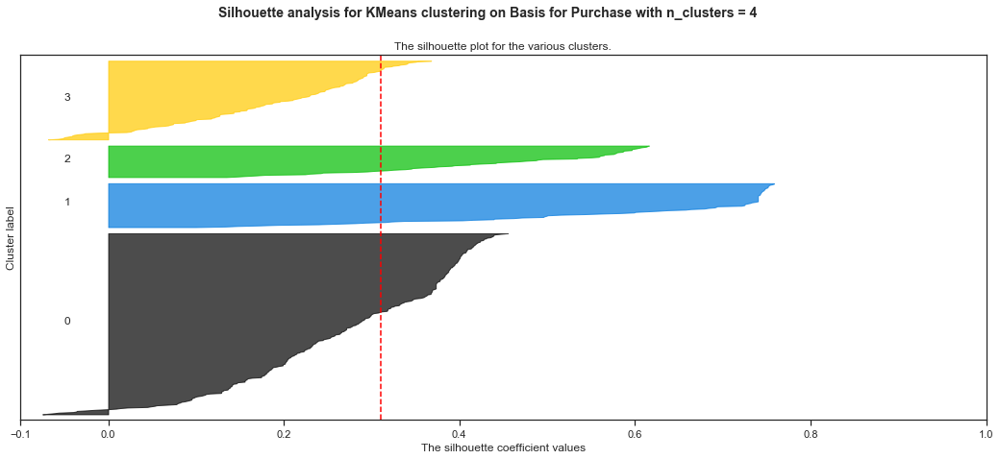

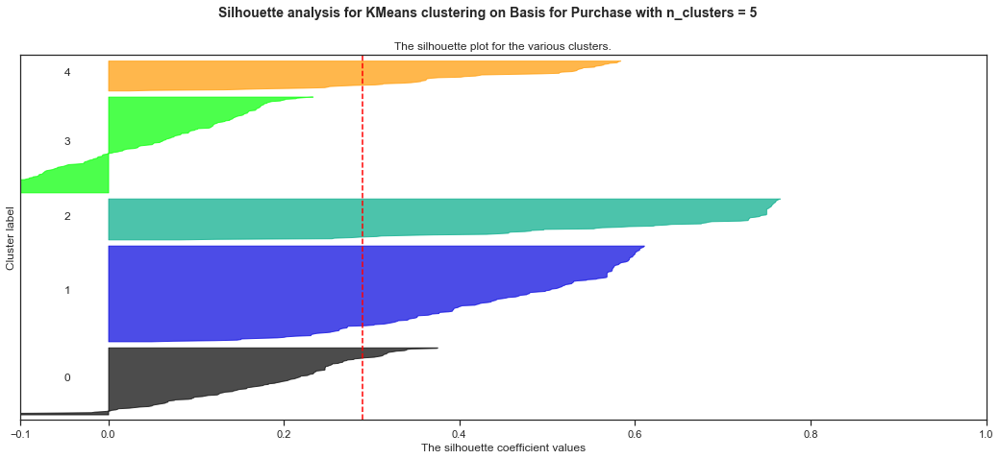

In [337]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm


range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    X = basisForPurchase
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on Basis for Purchase "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

For n_clusters = 2 The average silhouette_score is : 0.30390892227256316
For n_clusters = 3 The average silhouette_score is : 0.22353705884450487
For n_clusters = 4 The average silhouette_score is : 0.1889980215121062
For n_clusters = 5 The average silhouette_score is : 0.20246544661100807


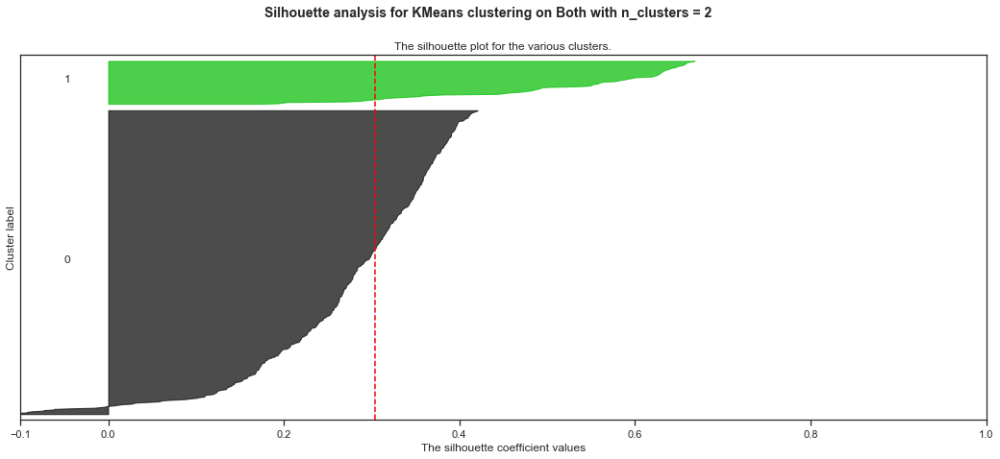

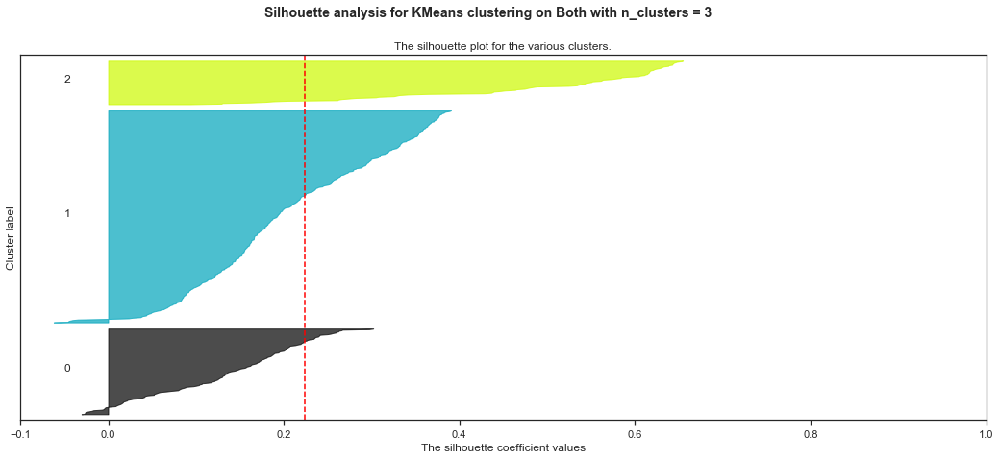

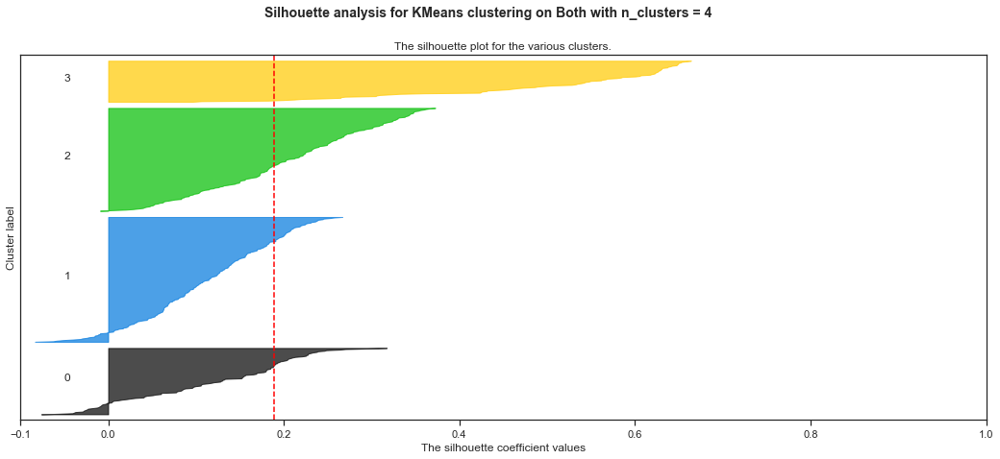

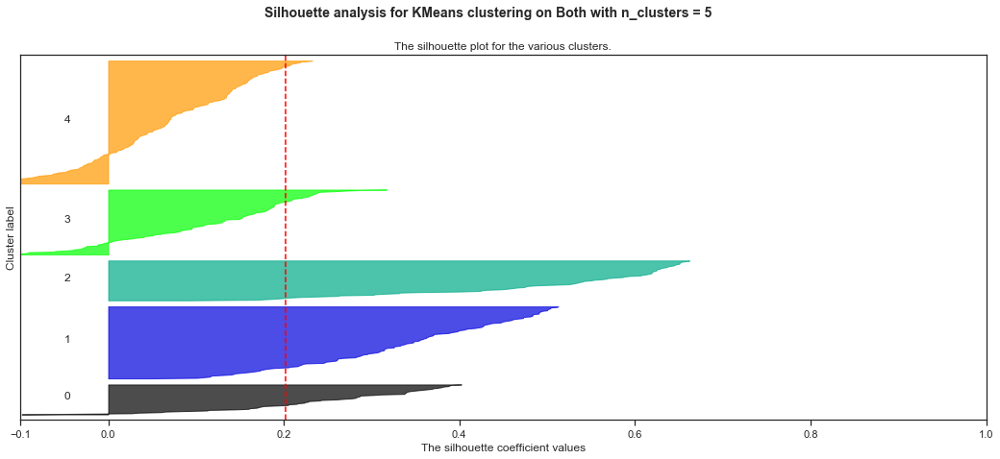

In [338]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm


range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    X = both
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on Both "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

In [339]:
kmeans = KMeans(n_clusters=3, random_state=0).fit(purchaseBehaviorDerived)
allData['preds'] = kmeans.predict(purchaseBehaviorDerived)
# sns.pairplot(purchaseBehaviorDerived, hue='preds')

In [340]:
demos = allData.loc[:,[
"SEC",
"MT",
"AGE",
"EDU",
"HS",
"Affluence Index",
"preds"
]]

purchaseBehaviorDerived = allData.loc[:, [
"No. of Brands",
"Brand Runs",
"Total Volume",
"No. of  Trans",
"Value",
"Trans / Brand Runs",
"Vol/Tran",
"Avg. Price",
"Pur Vol No Promo - %",
"Pur Vol Promo 6 %",
"Pur Vol Other Promo %",
# "Others 999",
"brandLoyalty",
"preds"
]]

propCat  = allData.loc[:,[
"PropCat 5",
"PropCat 6",
"PropCat 7",
"PropCat 8",
"PropCat 9",
"PropCat 10",
"PropCat 11",
"PropCat 12",
"PropCat 13",
"PropCat 14",
"PropCat 15",
"preds"
]]

priceCat  = allData.loc[:,[
"Pr Cat 1",
"Pr Cat 2",
"Pr Cat 3",
"Pr Cat 4",
"preds"
]]




In [341]:
allData

,SEC,MT,AGE,EDU,HS,Affluence Index,No. of Brands,Brand Runs,Total Volume,No. of Trans,...,PropCat 8,PropCat 9,PropCat 10,PropCat 11,PropCat 12,PropCat 13,PropCat 14,PropCat 15,brandLoyalty,preds
0,4,10,4,4,2,2,0.250,0.219178,0.155188,0.167883,...,0.000000,0.00000,0.00,0.000000,0.090909,0.00,0.13,0.404762,0.745098,0
1,3,10,2,4,4,19,0.500,0.328767,0.272441,0.284672,...,0.020833,0.02439,0.00,0.066667,0.000000,0.00,0.08,0.000000,0.583333,1
2,2,10,4,5,6,23,0.500,0.493151,0.452261,0.452555,...,0.010417,0.02439,0.00,0.000000,0.060606,0.00,0.56,0.000000,0.873016,1
3,4,0,4,0,0,0,0.125,0.041096,0.026604,0.021898,...,0.000000,0.00000,0.00,0.000000,0.000000,0.00,0.60,0.000000,0.600000,0
4,4,10,3,4,4,10,0.250,0.068493,0.160607,0.087591,...,0.052083,0.00000,0.00,0.000000,0.000000,0.00,0.14,0.000000,0.736842,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
595,2,10,4,5,5,15,0.250,0.054795,0.174894,0.153285,...,0.000000,0.00000,0.02,1.000000,0.000000,0.00,0.00,0.000000,1.000000,0
596,3,10,3,5,4,29,0.500,0.301370,0.096561,0.197080,...,0.156250,0.00000,0.04,0.000000,0.000000,0.09,0.00,0.059524,0.243902,1
597,3,17,4,4,9,13,0.375,0.246575,0.570500,0.175182,...,0.031250,0.00000,0.04,0.000000,0.000000,0.00,0.18,0.000000,0.555556,1
598,2,4,4,5,2,20,0.250,0.191781,0.105429,0.131387,...,0.000000,0.00000,0.00,0.000000,0.000000,0.03,0.14,0.000000,0.647059,0


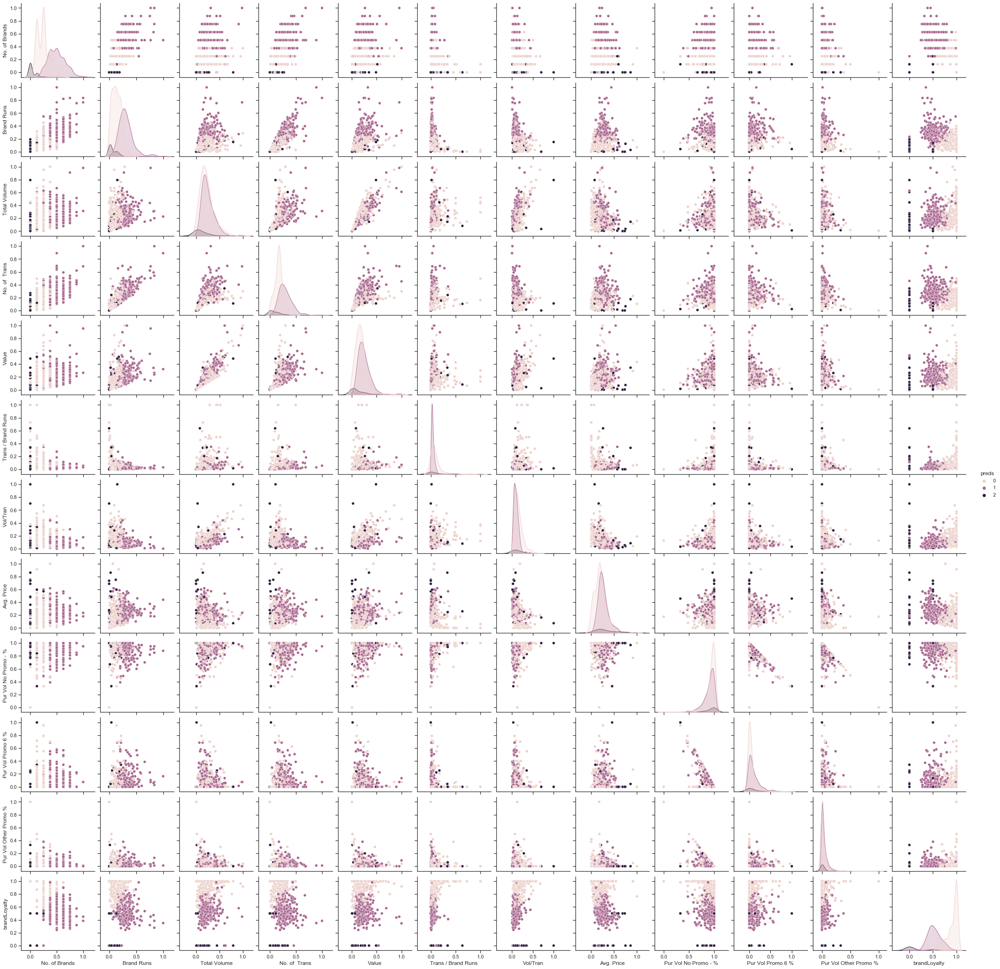

In [342]:
sns.pairplot(purchaseBehaviorDerived, hue='preds')

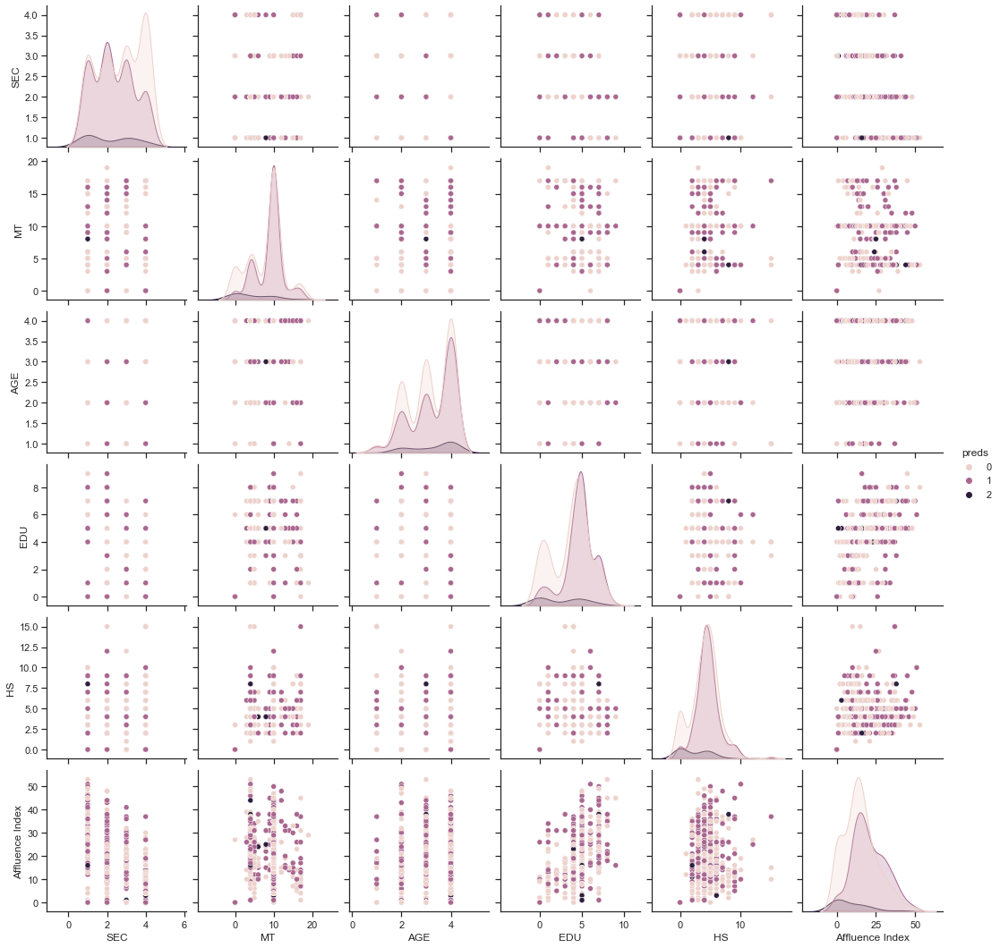

In [343]:
sns.pairplot(demos, hue='preds')

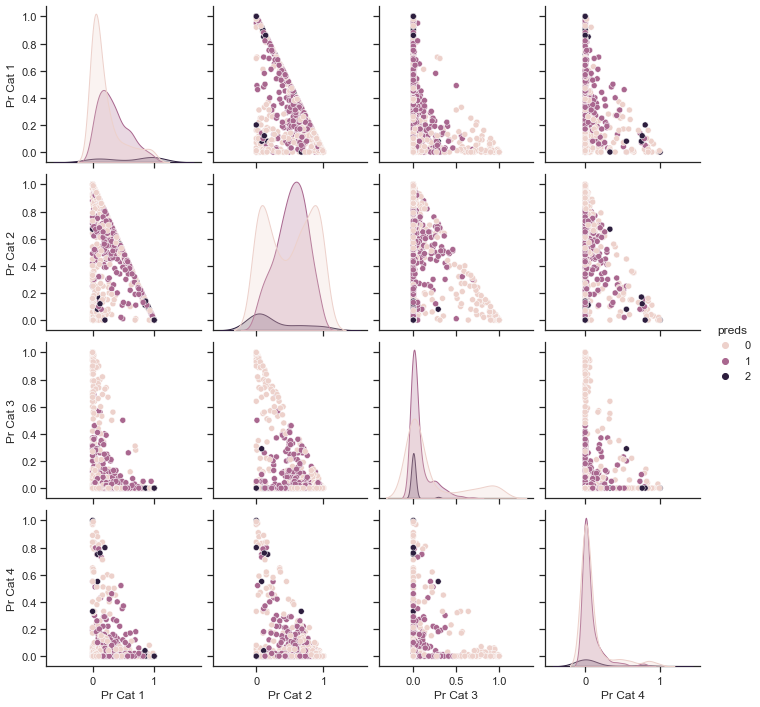

In [344]:
sns.pairplot(priceCat, hue='preds')

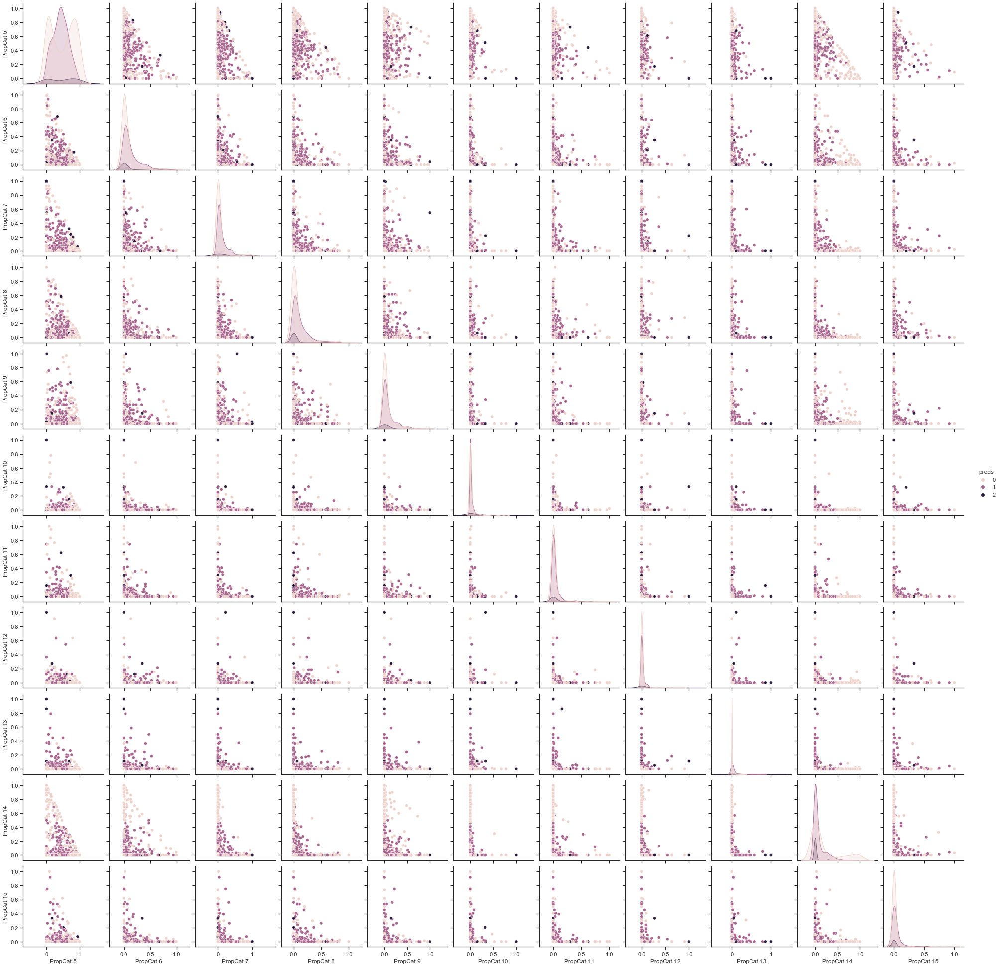

In [345]:
sns.pairplot(propCat, hue='preds')